In [4]:
import sys
import os
import pickle
import torch
import argparse
from datetime import datetime
import math
from gensim.models import KeyedVectors
from textwrap3 import wrap
from PIL import Image
import matplotlib.pyplot as plt

# Set environment variables
os.environ["TOKENIZERS_PARALLELISM"] = "false"


# Import custom modules
sys.path.insert(0, os.path.abspath('../../'))
sys.path.insert(0, os.path.abspath('../../../'))


from Multimodal_ZeroShotTM.utils import commonsense_ctm_utils
from Multimodal_ZeroShotTM.utils.commonsense_ctm_utils import CoherenceImageEmbeddings
from Multimodal_ZeroShotTM.utils.ImportDatasetTopicModeling import ImportDatasetTopicModeling
from Multimodal_ZeroShotTM.utils.preprocessing import WhiteSpacePreprocessing
from Multimodal_ZeroShotTM.utils.data_preparation import TopicModelDataPreparation
from Multimodal_ZeroShotTM.models.ctm_multimodal import ZeroShotTM



In [5]:
# Define parameters and hyperparameters
number_of_topic_models = 1  # Number of topic models to train
num_epochs = 50  # Number of training epochs
batch_size = 32  # Batch size for training
size_sampling = 4000 #None  # Size sampling, set to None for full dataset
list_number_of_topics = [25]  # List of number of topics to evaluate
text_enc_dim = 512  # Text encoder dimension
img_enc_dim = 512  # Image encoder dimension
sbert_model_name = 'clip_32'  # Name of the SBERT model to use
name_dataset = 'COCO'  # Name of the dataset, e.g., 'COCO' or 'VIST'
column_text_name = 'caption'  # Column name for text data in the dataset
image_id = 'image_id'  # Column name for image ID in the dataset
column_name_img_id = image_id  # Column name for image ID
column_name_image_path = 'img_path'  # Column name for image path in the dataset
type_of_model = 'ZeroShotTM'  # Type of model to use

# Path to datasets
datasets_path = '../../datasets_path.json'

# Sequence length and document sampling parameters
max_seq_length = 77  # Maximum sequence length for text data
num_doc_sampling = size_sampling #None  # Number of documents to sample, set to None for full dataset



In [6]:


# Flags for reconstructing features
reconstruct_img_features = True  # Flag to reconstruct image features

# Vocabulary size for Bag-of-Words
bow_size = 2000  # Size of the vocabulary

# List of stopwords for languages
lang_stopwords = ['english']  # List of stopwords languages



In [7]:
# Initialize the dataset for topic modeling
DatasetTopicModeling = ImportDatasetTopicModeling(
    name_dataset=name_dataset,
    datasets_path=datasets_path,
    size_sampling=num_doc_sampling,
    column_text_name=column_text_name
)


In [8]:

# Get documents and dataframe
documents, df = DatasetTopicModeling.get_dataset()

# Get paths for word2vec and SBERT model
word2vec_path = DatasetTopicModeling.get_word2vec_path()
sbert_model = DatasetTopicModeling.get_sbert_model_path(sbert_model_name)

# Generate a timestamp string for filenames
dt_string = datetime.now().strftime("_%m_%d")

print('Number of docs:', len(df))
df.head(1)

# Initialize the preprocessing pipeline
preproc_pipeline = WhiteSpacePreprocessing(
    documents=documents,
    vocabulary_size=bow_size,
    stopwords_language=lang_stopwords
)
# Optionally, use the preprocessing pipeline that removes stopwords
# preproc_pipeline = WhiteSpacePreprocessingStopwords(documents=documents)

print('Finished preproc_pipeline')

# Preprocess the documents
preprocessed_docs, unpreprocessed_docs, vocabulary, retained_indices = preproc_pipeline.preprocess()
print('Finished preprocessed_docs')
print('Size of dataframe:', len(df))

# Filter the dataframe based on unpreprocessed documents
df = df[df[column_text_name].isin(unpreprocessed_docs)]
print('After cleaning dataframe - Size:', len(df))
print('Number of unpreprocessed_corpus:', len(unpreprocessed_docs))

# Adjust the length of sentences
unpreprocessed_docs = commonsense_ctm_utils.adjust_length_sentences(sbert_model, unpreprocessed_docs, max_seq_length=max_seq_length)
print('Finished adjust_length_sentences, len(unpreprocessed_corpus):', len(unpreprocessed_docs))

# Load image embeddings and their indices
image_embeddings = DatasetTopicModeling.get_image_embeddings()
image_embeddings_index = DatasetTopicModeling.get_image_embeddings_index()

# Order the image embeddings based on the filtered dataframe
image_embeddings_ordered = []
image_embeddings_index_ordered = []

for index, row in df.iterrows():
    current_id = row[image_id]
    index_of_embedding = image_embeddings_index.index(current_id)
    current_image_embedding = image_embeddings[index_of_embedding]
    image_embeddings_ordered.append(current_image_embedding)
    image_embeddings_index_ordered.append(current_id)

# Convert ordered image embeddings to a tensor
image_embeddings_ordered = torch.stack(image_embeddings_ordered)

print('Processed documents:', len(preprocessed_docs))
print('Len image_embeddings_ordered:', len(image_embeddings_ordered))

# Initialize the topic model data preparation with the right image embeddings
qt = TopicModelDataPreparation(
    contextualized_model=sbert_model,
    image_embeddings=image_embeddings_ordered,
    image_embeddings_index=image_embeddings_index_ordered,
    max_seq_length=max_seq_length
)


Rows in dataset: 4000
Number of documents:  4000
Number of docs: 4000
Finished preproc_pipeline
Finished preprocessed_docs
Size of dataframe: 4000
After cleaning dataframe - Size: 3999
Number of unpreprocessed_corpus: 3999


/lustre06/project/6004340/pipegp/multimodal_neural_topic_modeling/Multimodal_ZeroShotTM/utils/preprocessing.py:24: UserWarning: WhiteSpacePreprocessing is deprecated and will be removed in future versions.Use WhiteSpacePreprocessingStopwords.
  warnings.warn("WhiteSpacePreprocessing is deprecated and will be removed in future versions."


../../data/clip-ViT-B-32
Finding tokenizer - clip
Identifying the max_seq_length from the model:  77
Number of sentences received 3999
Number of final sentences received 3999
Finished adjust_length_sentences, len(unpreprocessed_corpus): 3999
Processed documents: 3999
Len image_embeddings_ordered: 3999
Image embeddings  - Size 3999
Image embeddings index  - Size 3999


# Create model


In [9]:

print('Loading word embeddings...')
current_wv =  KeyedVectors.load_word2vec_format(
                word2vec_path, binary=True)


Loading word embeddings...


In [10]:

training_dataset = qt.fit(text_for_contextual=unpreprocessed_docs, text_for_bow=preprocessed_docs, multimodal=True)


Batches: 100%|██████████| 20/20 [00:00<00:00, 26.38it/s]


In [11]:
# Start timer to measure the total duration
start_time = datetime.now()

# Initialize a dictionary to store results for different numbers of topics
results_per_number_of_topics = {}

# Loop over each number of topics to be evaluated
for current_number_of_topics in list_number_of_topics:
    list_of_results_language_1 = []  # This will contain scores for N topic models with k topics
    
    # Loop over the number of topic models to be trained
    for i in range(number_of_topic_models):
        # Initialize the ZeroShotTM model with the specified parameters
        ctm_multimodal = ZeroShotTM(
            bow_size=len(qt.vocab),
            contextual_size=text_enc_dim,
            n_components=current_number_of_topics,
            num_epochs=num_epochs,
            batch_size=batch_size,
            img_enc_dim=img_enc_dim
        )
        
        # Load gensim models
        ctm_multimodal.wv = current_wv
        ctm_multimodal.word2vec_path = word2vec_path
        
        # Fit the model
        start_fit = datetime.now()
        ctm_multimodal.fit(training_dataset, multimodal=True, img_reconstruction=reconstruct_img_features,  txt_reconstruction = False)
        end_fit = datetime.now()
        
        # Split the preprocessed documents into words
        texts_splitted = [d.split() for d in preprocessed_docs]
        print('Number of docs:', len(texts_splitted))
        
        # Perform inference
        start_inference_image = datetime.now()
        training_doc_topic_distributions = ctm_multimodal.get_doc_topic_distribution(training_dataset)
        

        # Get top image embeddings for training data
        list_top_image_embeddings_training_data = ctm_multimodal.get_list_top_image_embeddings(training_doc_topic_distributions, training_dataset.image_embeddings)
        end_inference_image = datetime.now()
        
        # Get topics image embeddings
        list_top_image_embeddings_beta_img = ctm_multimodal.get_topics_image_embeddings_beta_img(training_dataset.image_embeddings.cuda(), training_dataset.image_embeddings_index)
        
        # Compute scores for the model
        current_scores = commonsense_ctm_utils.compute_scores(
            ctm_multimodal,
            ctm_multimodal.get_topic_lists(10),
            texts_splitted,
            apply_weco=True,
            apply_rbo=True,
            apply_npmi=True,
            apply_cv=True,
            apply_topic_diversity=True,
            w2v_embeddings=ctm_multimodal.wv,
            n_terms_topic_diversity=10,
            top_image_embeddings_training_data=list_top_image_embeddings_training_data,
            top_image_embeddings_beta_img=list_top_image_embeddings_beta_img
        )
        print(current_scores)
        print("=" * 30)
        
        # Calculate the time taken for fitting and inference
        delta_fit = (end_fit - start_fit).total_seconds()
        delta_inference = (end_inference_image - start_inference_image).total_seconds()
        
        # Store additional information in the scores
        current_scores['total_seconds_fit'] = delta_fit
        current_scores['total_seconds_inference'] = delta_inference
        current_scores['topics'] = ctm_multimodal.get_topic_lists(20)
        list_of_results_language_1.append(current_scores)
        
        print("=" * 30)
        print(ctm_multimodal.get_topic_lists(10))
        print(current_scores)
        print("=" * 30)
        
        # Save results for the current number of topics
        results_per_number_of_topics[str(current_number_of_topics)] = list_of_results_language_1

        
        # Print the duration so far
        end_time = datetime.now()
        print('Duration:', end_time - start_time)



Initializing CTM  Multimodal class
Current loss weights:  {'KL': 1, 'BoW_loss': 1, 'IMG_loss': 1, 'TXT_loss': 1}
ZeroShotTM THIS IS bert_size 512
ZeroShotTM THIS IS input_size 2000


/home/pipegp/.coling/lib/python3.10/site-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 48 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
0it [00:00, ?it/s]

---------- Epoch 1 ----------


/home/pipegp/.coling/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/pipegp/.coling/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
Epoch: [1/50]	 Seen Samples: [3968/199950]	Train Loss: 107.2497491528911	Time: 0:00:08.832627	Train RL BOW Loss: 44.571152164090066		Train  RL IMG Loss: 44.571152164090066	Train  KL Loss: 18.10744523232983	Train  RL text: 0.0	: : 1it [00:08,  8.83s/it]

MEAN New weight for txt loss nan
MEAN New weight for img loss 67.56362862075125
---------- Epoch 2 ----------


Epoch: [2/50]	 Seen Samples: [7936/199950]	Train Loss: 88.51764242110714	Time: 0:00:08.263161	Train RL BOW Loss: 43.55259052399666		Train  RL IMG Loss: 31.235501894436563	Train  KL Loss: 13.729549669450329	Train  RL text: 0.0	: : 2it [00:17,  8.50s/it]

---------- Epoch 3 ----------


Epoch: [3/50]	 Seen Samples: [11904/199950]	Train Loss: 76.0006227800923	Time: 0:00:08.474869	Train RL BOW Loss: 42.10290542725594		Train  RL IMG Loss: 21.7853794663318	Train  KL Loss: 12.112337381609025	Train  RL text: 0.0	: : 3it [00:25,  8.49s/it]  

---------- Epoch 4 ----------


Epoch: [4/50]	 Seen Samples: [15872/199950]	Train Loss: 72.42305472589308	Time: 0:00:08.134332	Train RL BOW Loss: 40.88383296228224		Train  RL IMG Loss: 20.218593865706666	Train  KL Loss: 11.320627389415618	Train  RL text: 0.0	: : 4it [00:33,  8.35s/it]

---------- Epoch 5 ----------


Epoch: [5/50]	 Seen Samples: [19840/199950]	Train Loss: 70.33003505583733	Time: 0:00:08.507822	Train RL BOW Loss: 40.08517622178601		Train  RL IMG Loss: 19.336581459370905	Train  KL Loss: 10.90827775770618	Train  RL text: 0.0	: : 5it [00:42,  8.41s/it] 

---------- Epoch 6 ----------


Epoch: [6/50]	 Seen Samples: [23808/199950]	Train Loss: 69.32859396165416	Time: 0:00:08.105936	Train RL BOW Loss: 39.541573801348285		Train  RL IMG Loss: 19.05832248326434	Train  KL Loss: 10.728697630666918	Train  RL text: 0.0	: : 6it [00:50,  8.31s/it]

---------- Epoch 7 ----------


Epoch: [7/50]	 Seen Samples: [27776/199950]	Train Loss: 68.54187316279257	Time: 0:00:08.230320	Train RL BOW Loss: 39.00086605933405		Train  RL IMG Loss: 18.841764382703058	Train  KL Loss: 10.699242314984721	Train  RL text: 0.0	: : 7it [00:58,  8.28s/it]

---------- Epoch 8 ----------


Epoch: [8/50]	 Seen Samples: [31744/199950]	Train Loss: 68.12733305654218	Time: 0:00:08.204620	Train RL BOW Loss: 38.76069548822218		Train  RL IMG Loss: 18.685368121153168	Train  KL Loss: 10.681269468799714	Train  RL text: 0.0	: : 8it [01:06,  8.26s/it]

---------- Epoch 9 ----------


Epoch: [9/50]	 Seen Samples: [35712/199950]	Train Loss: 67.7861795425415	Time: 0:00:08.189691	Train RL BOW Loss: 38.566945937372026		Train  RL IMG Loss: 18.540999112331306	Train  KL Loss: 10.678233761941232	Train  RL text: 0.0	: : 9it [01:14,  8.24s/it]

---------- Epoch 10 ----------


Epoch: [10/50]	 Seen Samples: [39680/199950]	Train Loss: 67.45113858868999	Time: 0:00:08.704074	Train RL BOW Loss: 38.35188481115526		Train  RL IMG Loss: 18.42034867037413	Train  KL Loss: 10.678904925623248	Train  RL text: 0.0	: : 10it [01:23,  8.38s/it]

---------- Epoch 11 ----------


Epoch: [11/50]	 Seen Samples: [43648/199950]	Train Loss: 67.26603914076283	Time: 0:00:08.318875	Train RL BOW Loss: 38.29747846049647		Train  RL IMG Loss: 18.29384254823882	Train  KL Loss: 10.67471771086416	Train  RL text: 0.0	: : 11it [01:31,  8.36s/it] 

---------- Epoch 12 ----------


Epoch: [12/50]	 Seen Samples: [47616/199950]	Train Loss: 67.0434634608607	Time: 0:00:08.574802	Train RL BOW Loss: 38.13153193073888		Train  RL IMG Loss: 18.243536759077255	Train  KL Loss: 10.668394196418024	Train  RL text: 0.0	: : 12it [01:40,  8.43s/it]

---------- Epoch 13 ----------


Epoch: [13/50]	 Seen Samples: [51584/199950]	Train Loss: 66.82861521936232	Time: 0:00:08.291263	Train RL BOW Loss: 38.04147643427695		Train  RL IMG Loss: 18.133562532591178	Train  KL Loss: 10.653576097180766	Train  RL text: 0.0	: : 13it [01:48,  8.39s/it]

---------- Epoch 14 ----------


Epoch: [14/50]	 Seen Samples: [55552/199950]	Train Loss: 66.58299227683774	Time: 0:00:08.231703	Train RL BOW Loss: 37.89878611410818		Train  RL IMG Loss: 18.02398749299565	Train  KL Loss: 10.660218684904036	Train  RL text: 0.0	: : 14it [01:57,  8.34s/it] 

---------- Epoch 15 ----------


Epoch: [15/50]	 Seen Samples: [59520/199950]	Train Loss: 66.31518037857548	Time: 0:00:08.383294	Train RL BOW Loss: 37.71449621262089		Train  RL IMG Loss: 17.941396256335445	Train  KL Loss: 10.659288014135052	Train  RL text: 0.0	: : 15it [02:05,  8.35s/it]

---------- Epoch 16 ----------


Epoch: [16/50]	 Seen Samples: [63488/199950]	Train Loss: 66.17165731614635	Time: 0:00:08.319141	Train RL BOW Loss: 37.603360606778054		Train  RL IMG Loss: 17.903483001157344	Train  KL Loss: 10.66481315705084	Train  RL text: 0.0	: : 16it [02:13,  8.34s/it]

---------- Epoch 17 ----------


Epoch: [17/50]	 Seen Samples: [67456/199950]	Train Loss: 66.08121462791196	Time: 0:00:08.335819	Train RL BOW Loss: 37.543079530039144		Train  RL IMG Loss: 17.875576609328082	Train  KL Loss: 10.662558263347995	Train  RL text: 0.0	: : 17it [02:22,  8.34s/it]

---------- Epoch 18 ----------


Epoch: [18/50]	 Seen Samples: [71424/199950]	Train Loss: 66.00184600583968	Time: 0:00:08.301552	Train RL BOW Loss: 37.47108382563437		Train  RL IMG Loss: 17.8671012316892	Train  KL Loss: 10.663660810839746	Train  RL text: 0.0	: : 18it [02:30,  8.33s/it]   

---------- Epoch 19 ----------


Epoch: [19/50]	 Seen Samples: [75392/199950]	Train Loss: 65.77161222888577	Time: 0:00:08.782278	Train RL BOW Loss: 37.36519256714852		Train  RL IMG Loss: 17.71950553659446	Train  KL Loss: 10.68691397482349	Train  RL text: 0.0	: : 19it [02:39,  8.47s/it]

---------- Epoch 20 ----------


Epoch: [20/50]	 Seen Samples: [79360/199950]	Train Loss: 65.77188636410621	Time: 0:00:08.199693	Train RL BOW Loss: 37.3084321483489		Train  RL IMG Loss: 17.79211878977748	Train  KL Loss: 10.671335089591242	Train  RL text: 0.0	: : 20it [02:47,  8.39s/it]

---------- Epoch 21 ----------


Epoch: [21/50]	 Seen Samples: [83328/199950]	Train Loss: 65.79888743738974	Time: 0:00:08.365590	Train RL BOW Loss: 37.30341099154565		Train  RL IMG Loss: 17.803011080599813	Train  KL Loss: 10.692464990000571	Train  RL text: 0.0	: : 21it [02:55,  8.38s/it]

---------- Epoch 22 ----------


Epoch: [22/50]	 Seen Samples: [87296/199950]	Train Loss: 65.60212178384104	Time: 0:00:08.456290	Train RL BOW Loss: 37.162549264969364		Train  RL IMG Loss: 17.730304838614426	Train  KL Loss: 10.709267639344738	Train  RL text: 0.0	: : 22it [03:04,  8.40s/it]

---------- Epoch 23 ----------


Epoch: [23/50]	 Seen Samples: [91264/199950]	Train Loss: 65.49842231504378	Time: 0:00:08.384925	Train RL BOW Loss: 37.12810079513058		Train  RL IMG Loss: 17.70033884183665	Train  KL Loss: 10.66998242562817	Train  RL text: 0.0	: : 23it [03:12,  8.40s/it]   

---------- Epoch 24 ----------


Epoch: [24/50]	 Seen Samples: [95232/199950]	Train Loss: 65.41602168544647	Time: 0:00:08.105228	Train RL BOW Loss: 37.065581844699		Train  RL IMG Loss: 17.675812986347186	Train  KL Loss: 10.674626473457582	Train  RL text: 0.0	: : 24it [03:20,  8.31s/it]

---------- Epoch 25 ----------


Epoch: [25/50]	 Seen Samples: [99200/199950]	Train Loss: 65.2315755967171	Time: 0:00:08.030663	Train RL BOW Loss: 36.97296084127119		Train  RL IMG Loss: 17.575809614710995	Train  KL Loss: 10.682805084413097	Train  RL text: 0.0	: : 25it [03:28,  8.23s/it]

---------- Epoch 26 ----------


Epoch: [26/50]	 Seen Samples: [103168/199950]	Train Loss: 65.31002275405392	Time: 0:00:08.745149	Train RL BOW Loss: 37.03127922550325		Train  RL IMG Loss: 17.581721755565944	Train  KL Loss: 10.697021392083936	Train  RL text: 0.0	: : 26it [03:37,  8.38s/it]

---------- Epoch 27 ----------


Epoch: [27/50]	 Seen Samples: [107136/199950]	Train Loss: 65.16630280402399	Time: 0:00:08.341690	Train RL BOW Loss: 36.89242046110092		Train  RL IMG Loss: 17.57939248065481	Train  KL Loss: 10.694489640574302	Train  RL text: 0.0	: : 27it [03:45,  8.37s/it] 

---------- Epoch 28 ----------


Epoch: [28/50]	 Seen Samples: [111104/199950]	Train Loss: 65.32895848058885	Time: 0:00:08.734080	Train RL BOW Loss: 36.949842806785334		Train  RL IMG Loss: 17.667051245741415	Train  KL Loss: 10.712063981640723	Train  RL text: 0.0	: : 28it [03:54,  8.48s/it]

---------- Epoch 29 ----------


Epoch: [29/50]	 Seen Samples: [115072/199950]	Train Loss: 65.20509849056121	Time: 0:00:08.010176	Train RL BOW Loss: 36.88602256774902		Train  RL IMG Loss: 17.62351484328486	Train  KL Loss: 10.695561416687504	Train  RL text: 0.0	: : 29it [04:02,  8.34s/it]  

---------- Epoch 30 ----------


Epoch: [30/50]	 Seen Samples: [119040/199950]	Train Loss: 65.02195819731682	Time: 0:00:08.484259	Train RL BOW Loss: 36.848445800042924		Train  RL IMG Loss: 17.48047340733165	Train  KL Loss: 10.693038994266141	Train  RL text: 0.0	: : 30it [04:11,  8.38s/it]

---------- Epoch 31 ----------


Epoch: [31/50]	 Seen Samples: [123008/199950]	Train Loss: 64.94331193739369	Time: 0:00:08.344058	Train RL BOW Loss: 36.7668404732981		Train  RL IMG Loss: 17.455548730314085	Train  KL Loss: 10.72092326225773	Train  RL text: 0.0	: : 31it [04:19,  8.37s/it]  

---------- Epoch 32 ----------


Epoch: [32/50]	 Seen Samples: [126976/199950]	Train Loss: 64.96251826132497	Time: 0:00:08.452767	Train RL BOW Loss: 36.77332765825333		Train  RL IMG Loss: 17.49492300496484	Train  KL Loss: 10.694267549822408	Train  RL text: 0.0	: : 32it [04:27,  8.40s/it]

---------- Epoch 33 ----------


Epoch: [33/50]	 Seen Samples: [130944/199950]	Train Loss: 64.82886022137058	Time: 0:00:08.203133	Train RL BOW Loss: 36.66257396821053		Train  RL IMG Loss: 17.475536021008907	Train  KL Loss: 10.690749675996843	Train  RL text: 0.0	: : 33it [04:36,  8.34s/it]

---------- Epoch 34 ----------


Epoch: [34/50]	 Seen Samples: [134912/199950]	Train Loss: 64.95610280190745	Time: 0:00:08.245049	Train RL BOW Loss: 36.752827121365456		Train  RL IMG Loss: 17.506288399560344	Train  KL Loss: 10.69698715209961	Train  RL text: 0.0	: : 34it [04:44,  8.31s/it]

---------- Epoch 35 ----------


Epoch: [35/50]	 Seen Samples: [138880/199950]	Train Loss: 64.7781979653143	Time: 0:00:08.572271	Train RL BOW Loss: 36.60857862041843		Train  RL IMG Loss: 17.432352932157897	Train  KL Loss: 10.73726604061742	Train  RL text: 0.0	: : 35it [04:52,  8.39s/it]  

---------- Epoch 36 ----------


Epoch: [36/50]	 Seen Samples: [142848/199950]	Train Loss: 64.81891496719852	Time: 0:00:08.409515	Train RL BOW Loss: 36.69326351534936		Train  RL IMG Loss: 17.412996346357577	Train  KL Loss: 10.71265499822555	Train  RL text: 0.0	: : 36it [05:01,  8.40s/it]

---------- Epoch 37 ----------


Epoch: [37/50]	 Seen Samples: [146816/199950]	Train Loss: 64.73019390721475	Time: 0:00:10.282293	Train RL BOW Loss: 36.60774169429656		Train  RL IMG Loss: 17.40683713929673	Train  KL Loss: 10.715614664939142	Train  RL text: 0.0	: : 37it [05:11,  8.96s/it]

---------- Epoch 38 ----------


Epoch: [38/50]	 Seen Samples: [150784/199950]	Train Loss: 64.49910769924041	Time: 0:00:08.718393	Train RL BOW Loss: 36.453536002866684		Train  RL IMG Loss: 17.326163276043946	Train  KL Loss: 10.71940823524229	Train  RL text: 0.0	: : 38it [05:20,  8.89s/it]

---------- Epoch 39 ----------


Epoch: [39/50]	 Seen Samples: [154752/199950]	Train Loss: 64.73781945628505	Time: 0:00:08.733078	Train RL BOW Loss: 36.60260505060996		Train  RL IMG Loss: 17.42110455097544	Train  KL Loss: 10.714109143903178	Train  RL text: 0.0	: : 39it [05:29,  8.84s/it] 

---------- Epoch 40 ----------


Epoch: [40/50]	 Seen Samples: [158720/199950]	Train Loss: 64.71839732508505	Time: 0:00:09.618404	Train RL BOW Loss: 36.58545331032045		Train  RL IMG Loss: 17.40264121952416	Train  KL Loss: 10.730302326140865	Train  RL text: 0.0	: : 40it [05:38,  9.08s/it]

---------- Epoch 41 ----------


Epoch: [41/50]	 Seen Samples: [162688/199950]	Train Loss: 64.46206800399288	Time: 0:00:08.415283	Train RL BOW Loss: 36.49397714676395		Train  RL IMG Loss: 17.273368987016788	Train  KL Loss: 10.69472208330708	Train  RL text: 0.0	: : 41it [05:47,  8.88s/it]

---------- Epoch 42 ----------


Epoch: [42/50]	 Seen Samples: [166656/199950]	Train Loss: 64.5812324400871	Time: 0:00:08.699572	Train RL BOW Loss: 36.55176817986273		Train  RL IMG Loss: 17.323208719840828	Train  KL Loss: 10.706255251361478	Train  RL text: 0.0	: : 42it [05:55,  8.83s/it]

---------- Epoch 43 ----------


Epoch: [43/50]	 Seen Samples: [170624/199950]	Train Loss: 64.56314016157582	Time: 0:00:08.182181	Train RL BOW Loss: 36.53532951108871		Train  RL IMG Loss: 17.34041180254373	Train  KL Loss: 10.68739866441296	Train  RL text: 0.0	: : 43it [06:03,  8.63s/it] 

---------- Epoch 44 ----------


Epoch: [44/50]	 Seen Samples: [174592/199950]	Train Loss: 64.47404498438681	Time: 0:00:08.287969	Train RL BOW Loss: 36.52891095992057		Train  RL IMG Loss: 17.27294993252829	Train  KL Loss: 10.672183759750858	Train  RL text: 0.0	: : 44it [06:12,  8.53s/it]

---------- Epoch 45 ----------


Epoch: [45/50]	 Seen Samples: [178560/199950]	Train Loss: 64.35767484480336	Time: 0:00:08.229347	Train RL BOW Loss: 36.453821659088135		Train  RL IMG Loss: 17.249285268803305	Train  KL Loss: 10.654568118433799	Train  RL text: 0.0	: : 45it [06:20,  8.44s/it]

---------- Epoch 46 ----------


Epoch: [46/50]	 Seen Samples: [182528/199950]	Train Loss: 64.48590506276777	Time: 0:00:08.506450	Train RL BOW Loss: 36.462919358284246		Train  RL IMG Loss: 17.3546480041503	Train  KL Loss: 10.668338014233496	Train  RL text: 0.0	: : 46it [06:29,  8.46s/it]  

---------- Epoch 47 ----------


Epoch: [47/50]	 Seen Samples: [186496/199950]	Train Loss: 64.38374070198306	Time: 0:00:08.770195	Train RL BOW Loss: 36.47987098078574		Train  RL IMG Loss: 17.256378269206472	Train  KL Loss: 10.647491178204936	Train  RL text: 0.0	: : 47it [06:37,  8.55s/it]

---------- Epoch 48 ----------


Epoch: [48/50]	 Seen Samples: [190464/199950]	Train Loss: 64.35801909046788	Time: 0:00:08.186342	Train RL BOW Loss: 36.44601069727251		Train  RL IMG Loss: 17.259549558413212	Train  KL Loss: 10.652458521627612	Train  RL text: 0.0	: : 48it [06:45,  8.44s/it]

---------- Epoch 49 ----------


Epoch: [49/50]	 Seen Samples: [194432/199950]	Train Loss: 64.42324032322053	Time: 0:00:08.732612	Train RL BOW Loss: 36.46804923395957		Train  RL IMG Loss: 17.323762471284823	Train  KL Loss: 10.631428349402643	Train  RL text: 0.0	: : 49it [06:54,  8.53s/it]

---------- Epoch 50 ----------


Epoch: [50/50]	 Seen Samples: [198400/199950]	Train Loss: 64.20891254178939	Time: 0:00:08.218852	Train RL BOW Loss: 36.370579027360485		Train  RL IMG Loss: 17.223565725484132	Train  KL Loss: 10.614767482203822	Train  RL text: 0.0	: : 50it [07:02,  8.46s/it]
Sampling: [20/20]: : 20it [02:46,  8.33s/it]


Number of docs: 3999


Sampling: [20/20]: : 20it [02:43,  8.20s/it]


Number of terms for topic diversity:  10
Duration Compute Scores: 0:00:11.117072
{'WECO': 0.23229349, 'IECO_training_data': 0.7026922441588509, 'IECO_beta_img': 0.7955053335295783, 'ImageEPS_training_data': 0.43752133748084276, 'ImageEPS_beta_img': 0.515000210105379, 'diversity_beta_img_embeddings': 0.5856599210699399, 'RBO': 0.9839685639304524, 'NPMI': 0.06689329108061917, 'cv': 0.4787363359133279, 'topic_diversity': 0.772}
[['field', 'herd', 'green', 'walking', 'dirt', 'sheep', 'cows', 'grass', 'lush', 'grazing'], ['woman', 'boy', 'girl', 'young', 'little', 'cake', 'child', 'baby', 'eating', 'holding'], ['train', 'station', 'bus', 'parked', 'yellow', 'tracks', 'track', 'blue', 'traveling', 'red'], ['clock', 'sky', 'airplane', 'plane', 'tower', 'luggage', 'large', 'runway', 'flying', 'airport'], ['street', 'city', 'buildings', 'traffic', 'cars', 'tall', 'light', 'building', 'road', 'side'], ['men', 'group', 'people', 'frisbee', 'standing', 'playing', 'two', 'young', 'couple', 'field']

# Most relevant images

In [12]:

def show_most_relevant_images_per_topic(topic_id, column_name_image_path, column_text_name, training_doc_topic_distributions, training_dataset, list_indices, topn=10):
    """
    Display the most relevant images for a given topic.

    Parameters:
    - topic_id: ID of the topic
    - column_name_image_path: Column name for image paths in the dataframe
    - column_text_name: Column name for text/captions in the dataframe
    - training_doc_topic_distributions: Document-topic distributions from the trained model
    - training_dataset: Dataset containing the training data
    - list_indices: List of indices for the top documents related to the topic
    - topn: Number of top images to display
    """
    
    # Initialize the plot
    plt.figure(figsize=(20, 14))
    
    # Loop through the topn images
    for i in range(topn):
        current_index = list_indices[i]
        current_photo_flickr_id = training_dataset.image_embeddings_index[current_index]
        current_path = df[df[image_id] == current_photo_flickr_id][column_name_image_path].item()
        
        # Load and display the image
        plt.subplot(2, topn, i + 1)
        image = Image.open(current_path)
        plt.imshow(image, extent=(i - 0.5, i + 0.5, -1.6, -0.6), origin="upper")
        plt.axis('off')
        
        # Optional: Add captions or other information
        # current_caption = training_data.loc[current_index][column_text_name]
        # plt.text(i, -1.7, "\n".join(wrap(current_caption, 20)), fontsize=10, style='oblique', ha='center', va='top', wrap=True, rotation=0)
    
    # Remove axis ticks
    ax = plt.gca()
    ax.axes.xaxis.set_ticks([])
    ax.axes.yaxis.set_ticks([])
    
    # Adjust layout and show the plot
    plt.tight_layout()
    plt.show()


Topic ID: 0 : ['field', 'herd', 'green', 'walking', 'dirt', 'sheep', 'cows', 'grass', 'lush', 'grazing']
torch.Size([10, 512])
IECO score: 0.709


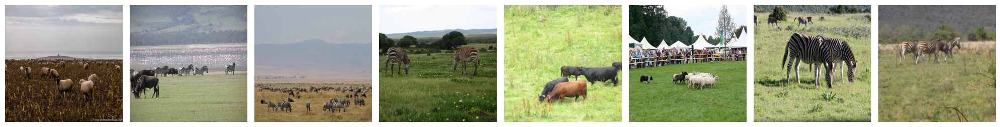

Topic ID: 1 : ['woman', 'boy', 'girl', 'young', 'little', 'cake', 'child', 'baby', 'eating', 'holding']
torch.Size([10, 512])
IECO score: 0.631


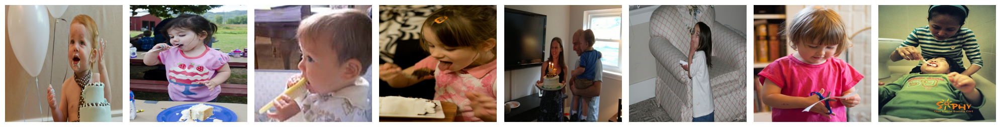

Topic ID: 2 : ['train', 'station', 'bus', 'parked', 'yellow', 'tracks', 'track', 'blue', 'traveling', 'red']
torch.Size([10, 512])
IECO score: 0.761


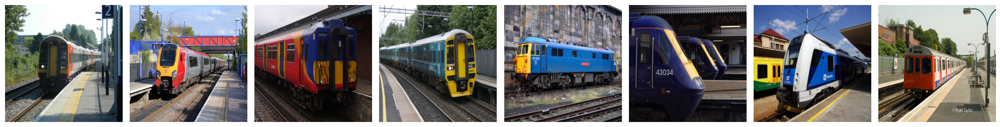

Topic ID: 3 : ['clock', 'sky', 'airplane', 'plane', 'tower', 'luggage', 'large', 'runway', 'flying', 'airport']
torch.Size([10, 512])
IECO score: 0.727


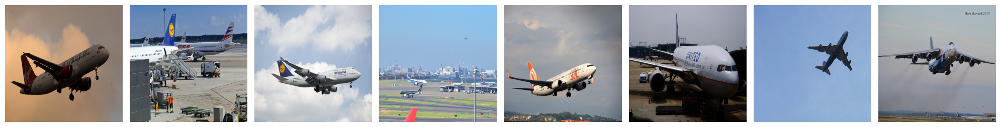

Topic ID: 4 : ['street', 'city', 'buildings', 'traffic', 'cars', 'tall', 'light', 'building', 'road', 'side']
torch.Size([10, 512])
IECO score: 0.672


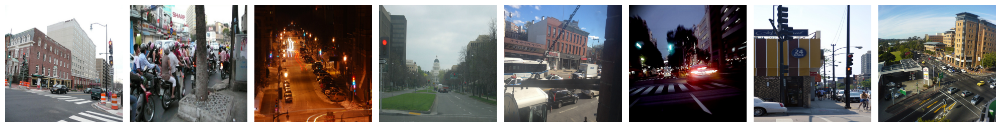

Topic ID: 5 : ['men', 'group', 'people', 'frisbee', 'standing', 'playing', 'two', 'young', 'couple', 'field']
torch.Size([10, 512])
IECO score: 0.566


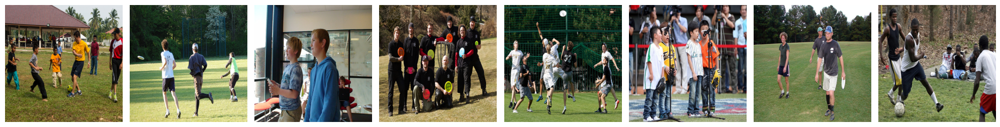

Topic ID: 6 : ['bus', 'parked', 'truck', 'train', 'road', 'double', 'driving', 'cars', 'station', 'decker']
torch.Size([10, 512])
IECO score: 0.654


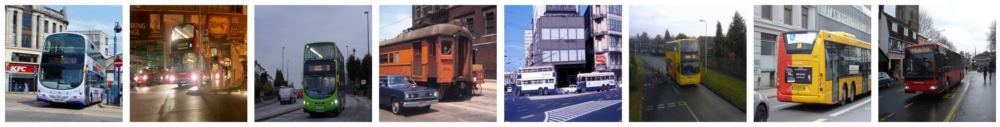

Topic ID: 7 : ['water', 'beach', 'boat', 'kite', 'boats', 'umbrellas', 'body', 'flying', 'ocean', 'kites']
torch.Size([10, 512])
IECO score: 0.624


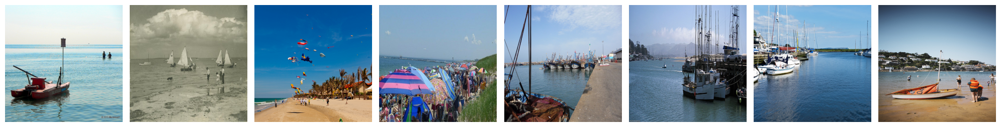

Topic ID: 8 : ['topped', 'pizza', 'vegetables', 'food', 'plate', 'plates', 'bowl', 'different', 'pan', 'placed']
torch.Size([10, 512])
IECO score: 0.72


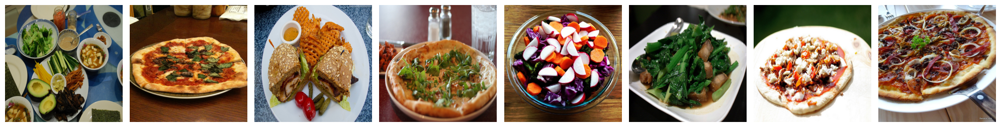

Topic ID: 9 : ['baseball', 'tennis', 'ball', 'game', 'playing', 'court', 'player', 'racquet', 'bat', 'racket']
torch.Size([10, 512])
IECO score: 0.607


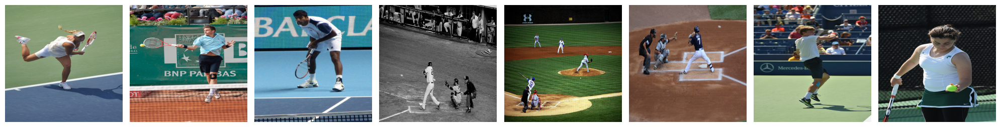

Topic ID: 10 : ['bottle', 'piece', 'slices', 'fruit', 'chocolate', 'banana', 'hot', 'apples', 'carrots', 'dish']
torch.Size([10, 512])
IECO score: 0.628


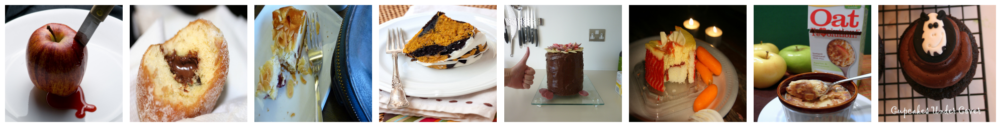

Topic ID: 11 : ['skateboard', 'ramp', 'skateboarder', 'riding', 'skate', 'jumping', 'trick', 'board', 'man', 'motorcycle']
torch.Size([10, 512])
IECO score: 0.82


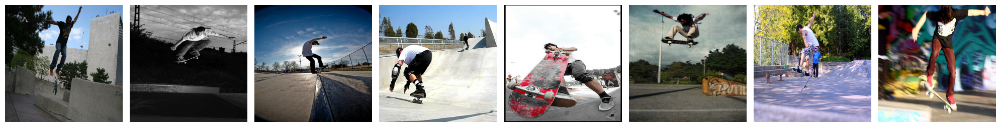

Topic ID: 12 : ['surfboard', 'wave', 'riding', 'surfer', 'board', 'person', 'surf', 'ocean', 'surfing', 'waves']
torch.Size([10, 512])
IECO score: 0.881


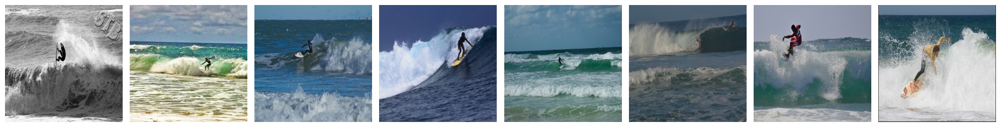

Topic ID: 13 : ['grass', 'bird', 'field', 'sheep', 'green', 'horse', 'grazing', 'herd', 'walking', 'lush']
torch.Size([10, 512])
IECO score: 0.635


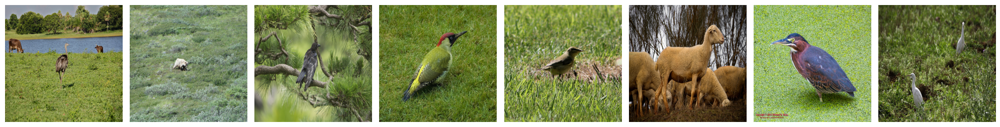

Topic ID: 14 : ['sign', 'fire', 'hydrant', 'red', 'stop', 'bench', 'front', 'yellow', 'sidewalk', 'green']
torch.Size([10, 512])
IECO score: 0.679


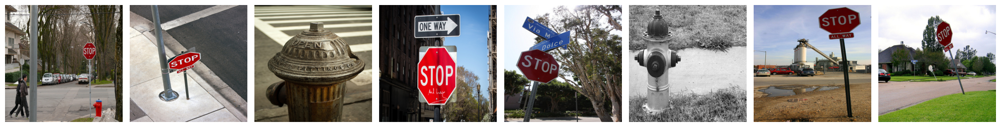

Topic ID: 15 : ['tennis', 'court', 'ball', 'baseball', 'player', 'racquet', 'game', 'holding', 'racket', 'bat']
torch.Size([10, 512])
IECO score: 0.632


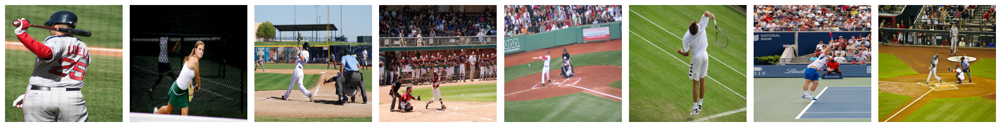

Topic ID: 16 : ['table', 'sitting', 'two', 'people', 'food', 'eating', 'group', 'around', 'women', 'couple']
torch.Size([10, 512])
IECO score: 0.622


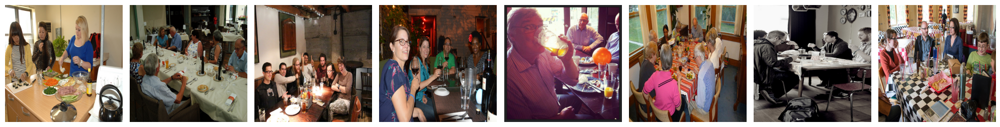

Topic ID: 17 : ['dog', 'black', 'bear', 'cat', 'laying', 'brown', 'teddy', 'stuffed', 'car', 'floor']
torch.Size([10, 512])
IECO score: 0.738


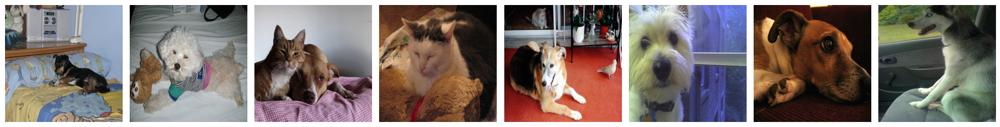

Topic ID: 18 : ['kitchen', 'living', 'room', 'vase', 'refrigerator', 'chairs', 'wall', 'flowers', 'stove', 'oven']
torch.Size([10, 512])
IECO score: 0.798


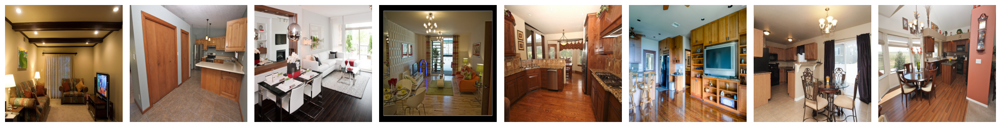

Topic ID: 19 : ['snow', 'skis', 'covered', 'ski', 'slope', 'hill', 'snowy', 'mountain', 'skiing', 'person']
torch.Size([10, 512])
IECO score: 0.771


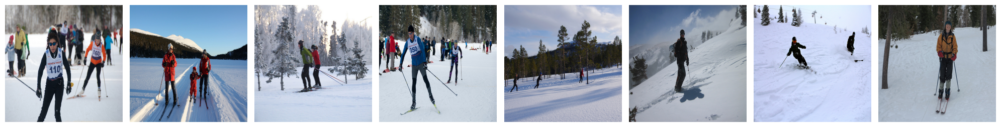

Topic ID: 20 : ['giraffe', 'elephant', 'standing', 'giraffes', 'zoo', 'fence', 'elephants', 'next', 'enclosure', 'zebra']
torch.Size([10, 512])
IECO score: 0.835


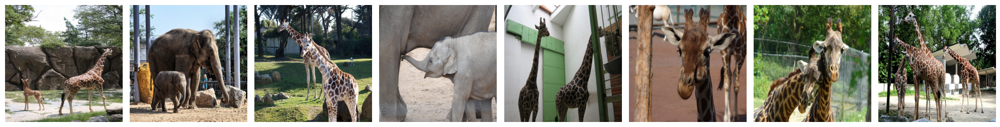

Topic ID: 21 : ['phone', 'man', 'tie', 'cell', 'wearing', 'hand', 'suit', 'holding', 'talking', 'shirt']
torch.Size([10, 512])
IECO score: 0.64


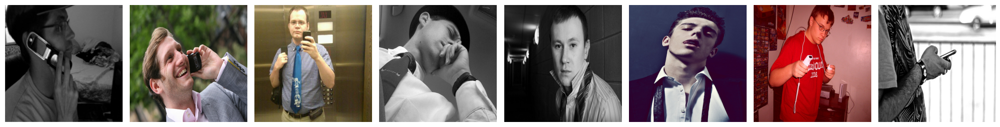

Topic ID: 22 : ['computer', 'desk', 'laptop', 'top', 'keyboard', 'monitor', 'sitting', 'cat', 'screen', 'bed']
torch.Size([10, 512])
IECO score: 0.766


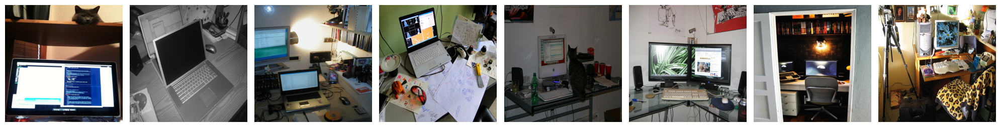

Topic ID: 23 : ['tennis', 'ball', 'court', 'baseball', 'player', 'game', 'playing', 'holding', 'racket', 'racquet']
torch.Size([10, 512])
IECO score: 0.603


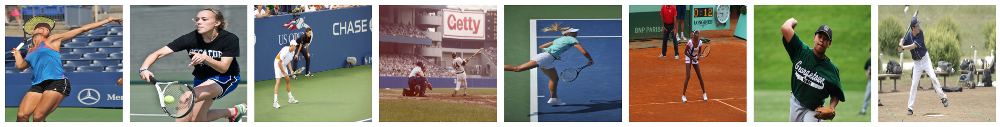

Topic ID: 24 : ['bathroom', 'toilet', 'sink', 'white', 'mirror', 'small', 'bath', 'tub', 'bed', 'shower']
torch.Size([10, 512])
IECO score: 0.846


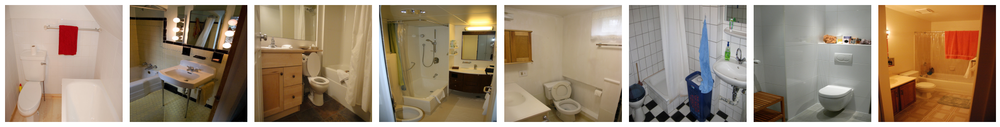

In [13]:
term_list = []

# Iterate over the range of current number of topics
for current_topic_id in range(current_number_of_topics):
    # Print the topic ID and the top 10 terms for the current topic
    print('Topic ID:', str(current_topic_id), ':', ctm_multimodal.get_topic_lists(10)[current_topic_id])
    
    # Get the indices of the top documents for the current topic
    current_list_indices = (-training_doc_topic_distributions).argsort(axis=0).T[current_topic_id]

    # Retrieve the image embeddings based on inference (topic distribution)
    closest_image_embeddings = ctm_multimodal.get_top_image_embeddings(
        current_topic_id, 
        training_doc_topic_distributions,
        image_embeddings_ordered, 
        top_n=10
    )
    
    print(closest_image_embeddings.shape)
    term_list.append(closest_image_embeddings)
    closest_image_embeddings = torch.Tensor(closest_image_embeddings)
    
    # Calculate and print the IECO score per topic
    ieco_score = round(CoherenceImageEmbeddings([closest_image_embeddings]).score(), 3)
    print('IECO score:', ieco_score)

    # Display the most relevant images for the current topic
    show_most_relevant_images_per_topic(
        current_topic_id,
        column_name_image_path,
        column_text_name,
        training_doc_topic_distributions,
        training_dataset,
        current_list_indices,
        topn=8
    )


In [14]:
#torch.save(ctm_multimodal,'example_25_topics_COCO_multimodal_ctm.pt', pickle_protocol=4)

In [15]:
ctm_multimodal.get_topic_lists()

[['field',
  'herd',
  'green',
  'walking',
  'dirt',
  'sheep',
  'cows',
  'grass',
  'lush',
  'grazing'],
 ['woman',
  'boy',
  'girl',
  'young',
  'little',
  'cake',
  'child',
  'baby',
  'eating',
  'holding'],
 ['train',
  'station',
  'bus',
  'parked',
  'yellow',
  'tracks',
  'track',
  'blue',
  'traveling',
  'red'],
 ['clock',
  'sky',
  'airplane',
  'plane',
  'tower',
  'luggage',
  'large',
  'runway',
  'flying',
  'airport'],
 ['street',
  'city',
  'buildings',
  'traffic',
  'cars',
  'tall',
  'light',
  'building',
  'road',
  'side'],
 ['men',
  'group',
  'people',
  'frisbee',
  'standing',
  'playing',
  'two',
  'young',
  'couple',
  'field'],
 ['bus',
  'parked',
  'truck',
  'train',
  'road',
  'double',
  'driving',
  'cars',
  'station',
  'decker'],
 ['water',
  'beach',
  'boat',
  'kite',
  'boats',
  'umbrellas',
  'body',
  'flying',
  'ocean',
  'kites'],
 ['topped',
  'pizza',
  'vegetables',
  'food',
  'plate',
  'plates',
  'bowl',
  'di